In [73]:
import pandas as pd
import numpy as np
#import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import os

#################################### A MODIFIER SELON SA PROPRE ARBORESCENCE
project_path = 'D:/Projet/mai25_bds_extraction/' 
####################################

In [74]:
df_extract  = pd.read_csv(os.path.join(project_path, 'data', 'extracted', 'rvl_cdip_draft1.csv'), index_col='Unnamed: 0')
df_extract

,relative_path,filename,format,width,height,mode,nb_pages,nettete,bruit_grain,ratio_b,ratio_n
0,imagesa\a\a\a\aaa06d00,50486482-6482.tif,TIFF,754.0,1000.0,L,1.0,0.007204,5.966084,0.950850,0.007538
1,imagesa\a\a\a\aaa08d00,2072197187.tif,TIFF,754.0,1000.0,L,1.0,0.017441,14.017837,0.854666,0.056966
2,imagesa\a\a\a\aaa09e00,2029372116.tif,TIFF,776.0,1000.0,L,1.0,0.004449,4.229207,0.961481,0.017421
3,imagesa\a\a\a\aaa10c00,2085133627a.tif,TIFF,754.0,1000.0,L,1.0,0.001255,1.049581,0.990841,0.002753
4,imagesa\a\a\a\aaa11d00,515558347+-8348.tif,TIFF,754.0,1000.0,L,1.0,0.013109,12.336960,0.868765,0.069794
...,...,...,...,...,...,...,...,...,...,...,...
399995,imagesz\z\z\z\zzz77d00,2064857737.tif,TIFF,754.0,1000.0,L,1.0,0.000810,0.732240,0.993844,0.001695
399996,imagesz\z\z\z\zzz83c00,2057775423.tif,TIFF,754.0,1000.0,L,1.0,0.003477,3.030334,0.971755,0.007659
399997,imagesz\z\z\z\zzz85c00,2073684077.tif,TIFF,754.0,1000.0,L,1.0,0.009873,9.512224,0.917780,0.030898
399998,imagesz\z\z\z\zzz86c00,2070718633.tif,TIFF,754.0,1000.0,L,1.0,0.007966,9.273898,0.771431,0.078243


In [75]:
for col in ['format', 'nb_pages', 'height', 'mode']:
    display(df_extract[col].value_counts())
    print('')

format
TIFF    399999
Name: count, dtype: int64

nb_pages
1.0    399999
Name: count, dtype: int64

height
1000.0    399999
Name: count, dtype: int64

mode
L    399999
Name: count, dtype: int64

In [76]:
#On regarde s'il y a des données manquantes
df_extract.isna().sum()

relative_path    0
filename         0
format           1
width            1
height           1
mode             1
nb_pages         1
nettete          1
bruit_grain      1
ratio_b          1
ratio_n          1
dtype: int64

In [77]:
# Filtrer les lignes où 'width' est NaN
nan_width_paths = df_extract[df_extract['width'].isna()]['relative_path']

# Afficher les chemins relatifs concernés
print(nan_width_paths)

#Après inspection, il s'avère que imagese/e/j/e/eje42e00 est corrompu, et que imagese/e/j/e/eje42e00/.ipynb_checkpoints ne devrait pas être là 
#ça explique aussi pourquoi il y avait 400 001 fichiers au départ au lieu de 400 000

68944    imagese\e\j\e\eje42e00
Name: relative_path, dtype: object


In [78]:
#ok, j'enlève les 2 images pour pouvoir faire mes stats
df_extract=df_extract.dropna(axis=0, how='any')
df_extract.info()

<class 'pandas.core.frame.DataFrame'>
Index: 399999 entries, 0 to 399999
Data columns (total 11 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   relative_path  399999 non-null  object 
 1   filename       399999 non-null  object 
 2   format         399999 non-null  object 
 3   width          399999 non-null  float64
 4   height         399999 non-null  float64
 5   mode           399999 non-null  object 
 6   nb_pages       399999 non-null  float64
 7   nettete        399999 non-null  float64
 8   bruit_grain    399999 non-null  float64
 9   ratio_b        399999 non-null  float64
 10  ratio_n        399999 non-null  float64
dtypes: float64(7), object(4)
memory usage: 36.6+ MB


## Exploration des données de largeur

In [95]:
q5_w = np.percentile(df_extract['width'], 5)
q95_w = np.percentile(df_extract['width'], 95)

print("90% des données sont entre ",q5,' et ', q95)

90% des données sont entre  0.00095066091895387  et  0.01999715510480804


In [13]:
print("Moyenne :", df_extract['width'].mean())
print("Médiane :", df_extract['width'].median())
print("Écart-type :", df_extract['width'].std())

Moyenne : 766.3619634049085
Médiane : 762.0
Écart-type : 27.00261230003947


In [14]:
# Illisibles 
# plt.hist(df_extract['width'], bins=60)
# plt.show()

# plt.figure(figsize=(15,7))
# plt.hist(df_extract['width'], bins=80)
# plt.show()

# df_extract.boxplot(column='width')
# plt.show()

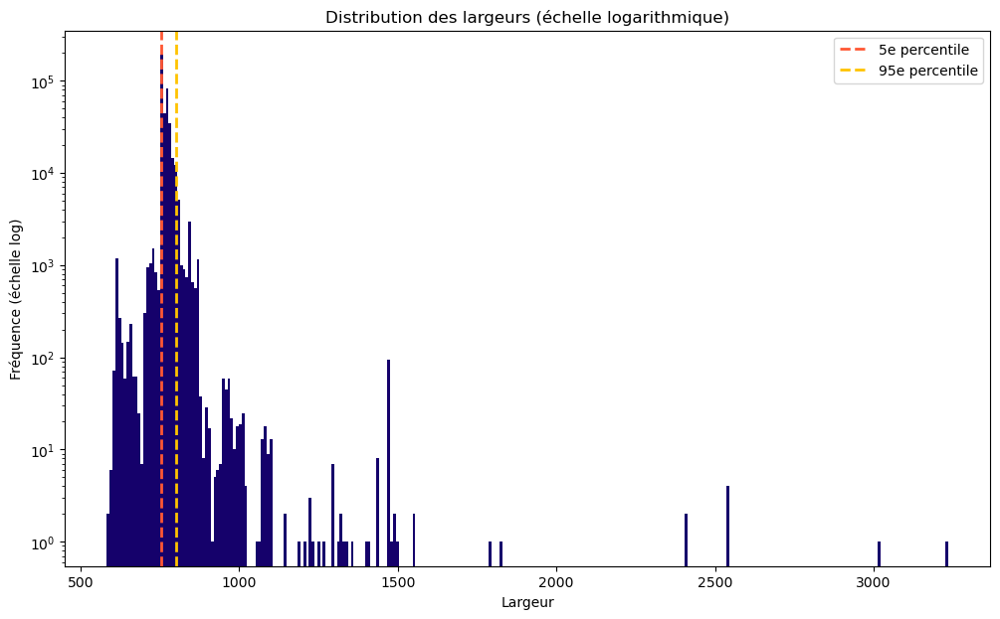

In [97]:
# On fait ça en échelle log pour y voir plus clair
plt.figure(figsize=(12,7))
plt.hist(df_extract['width'], bins=300, log=True, color='#15016B')
plt.axvline(q5_w, color='#FF5733', linestyle='dashed', linewidth=2, label='5e percentile')
plt.axvline(q95_w, color='#FFC300', linestyle='dashed', linewidth=2, label='95e percentile')
plt.legend()
plt.xlabel("Largeur")
plt.ylabel("Fréquence (échelle log)")
plt.title("Distribution des largeurs (échelle logarithmique)")
plt.show()

In [126]:
large_cat

66927      4
187818     6
197722     9
243953     3
353171    13
361619     4
Name: cat, dtype: int64

In [127]:
# Filtrer les lignes où 'width' est supérieur à 2500 pour aller regarder à quoi correspondent ces images
large_width_paths = df_extract[df_extract['width']>2500]['relative_path'].to_list()
large_width_file = df_extract[df_extract['width']>2500]['filename'].to_list()
large_cat = df[df['width']>2500]['cat'].to_list()

# Afficher les chemins relatifs concernés
for i in range (len(large_width_paths)):
    print(large_width_paths[i]," : ", large_width_file[i]," : ", large_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)

imagese\e\f\y\efy13e00  :  2061003307.tif  :  4
imagesl\l\v\l\lvl97e00  :  1000080993_1000080996.tif  :  6
imagesm\m\l\i\mli94e00  :  1003042957.tif  :  9
imagesp\p\i\b\pib24d00  :  507669571_507669572.tif  :  3
imagesx\x\c\g\xcg45d00  :  1002481794_1799.tif  :  13
imagesx\x\p\y\xpy13e00  :  2061003272.tif  :  4


## Exploration de la netteté

In [98]:
q5_n = np.percentile(df_extract['nettete'], 5)
q95_n = np.percentile(df_extract['nettete'], 95)

print("90% des données sont entre ",q5_n,' et ', q95_n)

90% des données sont entre  0.00095066091895387  et  0.01999715510480804


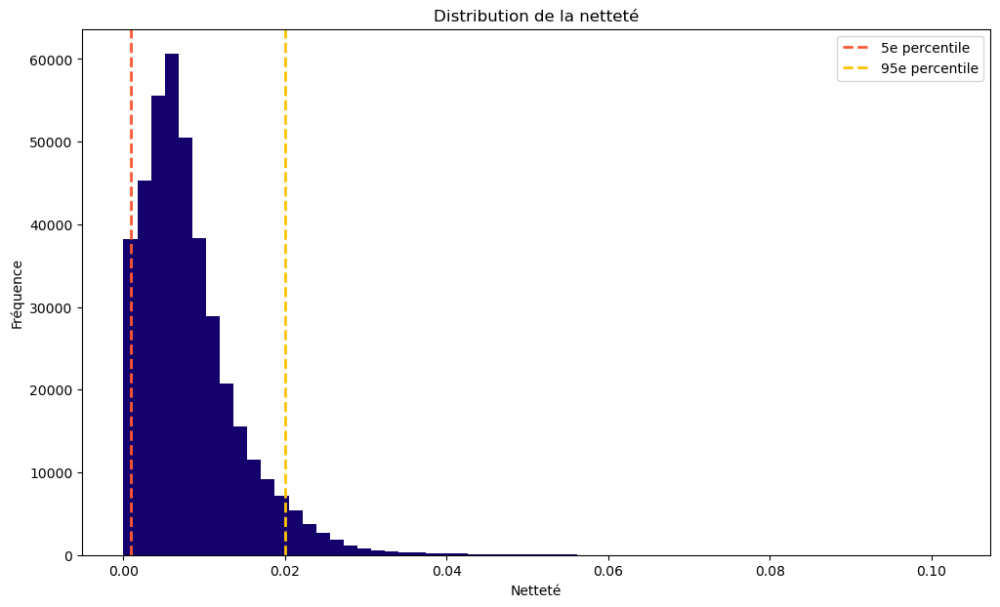

In [99]:
plt.figure(figsize=(12,7))
plt.hist(df_extract['nettete'], bins=60, color='#15016B')
plt.axvline(q5_n, color='#FF5733', linestyle='dashed', linewidth=2, label='5e percentile')
plt.axvline(q95_n, color='#FFC300', linestyle='dashed', linewidth=2, label='95e percentile')
plt.legend()
plt.xlabel("Netteté")
plt.ylabel("Fréquence")
plt.title("Distribution de la netteté")
plt.show()

In [129]:
#Voyons quelle est l'image la moins nette, et l'image la plus nette !
# Filtrer les lignes où 'width' est supérieur à 2500 pour aller regarder à quoi correspondent ces images
peu_net_width_paths = df_extract[df_extract['nettete']<0.00005]['relative_path'].to_list()
peu_net_width_file = df_extract[df_extract['nettete']<0.00005]['filename'].to_list()
peu_net_cat = df[df['nettete']<0.00005]['cat'].to_list()

# Afficher les chemins relatifs concernés
for i in range (len(peu_net_width_paths)):
    print(peu_net_width_paths[i]," : ", peu_net_width_file[i]," : ", peu_net_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)




imagesa\a\b\a\aba85f00  :  0060130511.tif  :  8
imagesa\a\f\y\afy33e00  :  2044156090.tif  :  8
imagesa\a\h\b\ahb43e00  :  2042467734.tif  :  8
imagesj\j\u\b\jub09d00  :  50425558-5560.tif  :  14
imagesm\m\l\i\mli94e00  :  1003042957.tif  :  9
imagesm\m\o\r\mor18e00  :  1002646569_1002646576.tif  :  0
imagesp\p\i\b\pib24d00  :  507669571_507669572.tif  :  3
imagesx\x\c\g\xcg45d00  :  1002481794_1799.tif  :  13
imagesz\z\f\o\zfo09d00  :  50449540-9542.tif  :  14
imagesz\z\n\d\znd80e00  :  91383708-a.tif  :  8


In [133]:
#Voyons quelle est l'image la moins nette, et l'image la plus nette !
# Filtrer les lignes où 'width' est supérieur à 2500 pour aller regarder à quoi correspondent ces images
tres_net_width_paths = df_extract[df_extract['nettete']>0.06]['relative_path'].to_list()
tres_net_width_file = df_extract[df_extract['nettete']>0.06]['filename'].to_list()
tres_net_cat = df[df['nettete']>0.06]['cat'].to_list()

# Afficher les chemins relatifs concernés
for i in range (len(tres_net_width_paths)):
    print(tres_net_width_paths[i]," : ", tres_net_width_file[i]," : ", tres_net_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)

imagesa\a\a\t\aat87d00  :  2078606262_6270.tif  :  12
imagesa\a\h\m\ahm22d00  :  2061547393.tif  :  8
imagesa\a\k\q\akq84a00  :  2078443971_4002.tif  :  12
imagesa\a\y\h\ayh19c00  :  2078582096.tif  :  12
imagesb\b\n\q\bnq84a00  :  2078443770_3784.tif  :  12
imagesb\b\w\h\bwh19c00  :  2078582534.tif  :  12
imagesc\c\w\w\cww57c00  :  2073373227.tif  :  4
imagesc\c\x\a\cxa75f00  :  0060221715.tif  :  8
imagesd\d\a\g\dag34f00  :  0060247411.tif  :  8
imagesd\d\s\k\dsk27d00  :  2072165561_5568.tif  :  12
imagesd\d\y\h\dyh19c00  :  2078582099_2103.tif  :  12
imagese\e\t\h\eth19c00  :  2078582370_2376.tif  :  12
imagese\e\u\k\euk77d00  :  2076269927_9945.tif  :  12
imagese\e\x\d\exd88d00  :  502484344_502484347.tif  :  3
imagese\e\x\f\exf19e00  :  2062414382_2062414401.tif  :  12
imagesf\f\e\p\fep70c00  :  2078614543_4612.tif  :  12
imagesf\f\h\c\fhc69c00  :  50146172-6172.tif  :  11
imagesf\f\s\l\fsl75c00  :  2078468514_8565.tif  :  12
imagesf\f\s\t\fst85a00  :  501286651+-6651.tif  :  4
im

## Exploration du bruit

In [102]:
q5_b = np.percentile(df_extract['bruit_grain'], 5)
q95_b = np.percentile(df_extract['bruit_grain'], 95)

print("90% des données sont entre ",q5_b,' et ', q95_b)

90% des données sont entre  1.0063507212626275  et  17.357731091663844


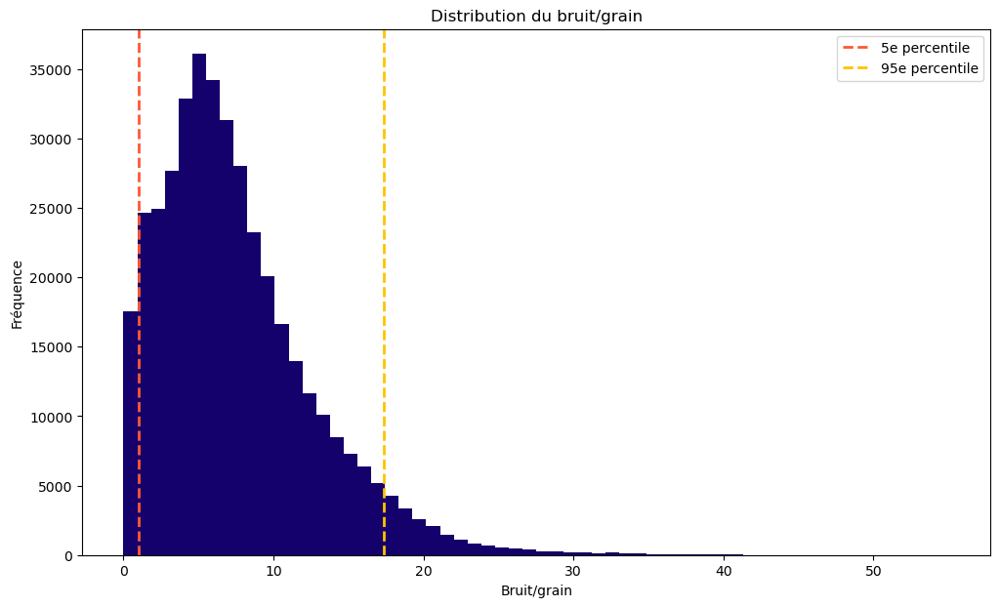

In [103]:
plt.figure(figsize=(12,7))
plt.hist(df_extract['bruit_grain'], bins=60, color='#15016B')
plt.axvline(q5_b, color='#FF5733', linestyle='dashed', linewidth=2, label='5e percentile')
plt.axvline(q95_b, color='#FFC300', linestyle='dashed', linewidth=2, label='95e percentile')
plt.legend()
plt.xlabel("Bruit/grain")
plt.ylabel("Fréquence")
plt.title("Distribution du bruit/grain")
plt.show()

In [135]:
#Voyons les images avec peu de bruit
# Filtrer les lignes où 'width' est supérieur à 2500 pour aller regarder à quoi correspondent ces images
b_paths = df_extract[df_extract['bruit_grain']<0.06]['relative_path'].to_list()
b_file = df_extract[df_extract['bruit_grain']<0.06]['filename'].to_list()
b_cat = df[df['bruit_grain']<0.06]['cat'].to_list()

# Afficher les chemins relatifs concernés
for i in range (len(b_paths)):
    print(b_paths[i]," : ", b_file[i]," : ", b_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)

imagesa\a\b\a\aba85f00  :  0060130511.tif  :  8
imagesa\a\f\y\afy33e00  :  2044156090.tif  :  8
imagesa\a\h\b\ahb43e00  :  2042467734.tif  :  8
imagesh\h\l\h\hlh09d00  :  50436305-6307.tif  :  14
imagesj\j\e\e\jee43e00  :  2041783653.tif  :  8
imagesj\j\u\b\jub09d00  :  50425558-5560.tif  :  14
imagesk\k\c\c\kcc60e00  :  92588163.tif  :  8
imagesm\m\o\r\mor18e00  :  1002646569_1002646576.tif  :  0
imagesn\n\l\x\nlx33e00  :  2044743126.tif  :  8
imagesn\n\y\h\nyh33e00  :  2504075165.tif  :  8
imagesr\r\j\e\rje80e00  :  91383093.tif  :  8
imagesv\v\d\e\vde09d00  :  50429899-9901.tif  :  14
imagesx\x\m\y\xmy33e00  :  2043894797.tif  :  8
imagesz\z\f\o\zfo09d00  :  50449540-9542.tif  :  14
imagesz\z\n\d\znd80e00  :  91383708-a.tif  :  8


In [136]:
#Voyons les images avec beaucoup de bruit
# Filtrer les lignes selon le bruit
gb_paths = df_extract[df_extract['bruit_grain']>40]['relative_path'].to_list()
gb_file = df_extract[df_extract['bruit_grain']>40]['filename'].to_list()
gb_cat = df[df['bruit_grain']>40]['cat'].to_list()

# Afficher les chemins relatifs concernés
for i in range (len(b_paths)):
    print(gb_paths[i]," : ", gb_file[i]," : ", gb_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)

imagesa\a\h\m\ahm22d00  :  2061547393.tif  :  8
imagesa\a\i\m\aim81a00  :  1000355767_1000355768.tif  :  13
imagesa\a\s\e\ase23f00  :  0000163298.tif  :  13
imagesb\b\q\o\bqo81a00  :  1000370927.tif  :  13
imagesc\c\c\f\ccf12a00  :  1005080772.tif  :  4
imagesc\c\r\r\crr11a00  :  0071000464.tif  :  8
imagesc\c\x\t\cxt57e00  :  2031495224.tif  :  8
imagesd\d\a\g\dag34f00  :  0060247411.tif  :  8
imagesd\d\a\m\dam81a00  :  1000352725_1000352727.tif  :  13
imagesd\d\t\m\dtm81a00  :  1000359696.tif  :  13
imagese\e\m\a\ema43e00  :  2043079593.tif  :  8
imagese\e\r\g\erg18e00  :  1001766503_1001766505.tif  :  5
imagese\e\t\z\etz94e00  :  2042014839_2042014840.tif  :  4
imagese\e\x\d\exd88d00  :  502484344_502484347.tif  :  3
imagesf\f\h\c\fhc69c00  :  50146172-6172.tif  :  11


## Exploration du ratio_b

In [104]:
q5_rb = np.percentile(df_extract['ratio_b'], 5)
q95_rb = np.percentile(df_extract['ratio_b'], 95)

print("90% des données sont entre ",q5_rb,' et ', q95_rb)

90% des données sont entre  0.6823139252173736  et  0.9890954907161804


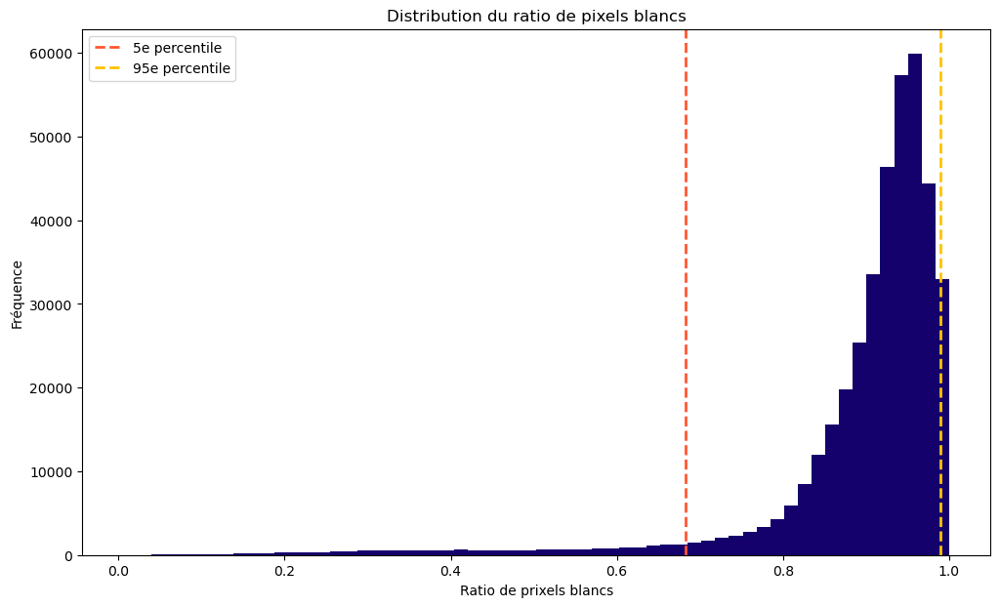

In [106]:
plt.figure(figsize=(12,7))
plt.hist(df_extract['ratio_b'], bins=60, color='#15016B')
plt.axvline(q5_rb, color='#FF5733', linestyle='dashed', linewidth=2, label='5e percentile')
plt.axvline(q95_rb, color='#FFC300', linestyle='dashed', linewidth=2, label='95e percentile')
plt.legend()
plt.xlabel("Ratio de prixels blancs")
plt.ylabel("Fréquence")
plt.title("Distribution du ratio de pixels blancs")
plt.show()

## Exploration du ratio noir

In [107]:
q5_rn = np.percentile(df_extract['ratio_n'], 5)
q95_rn = np.percentile(df_extract['ratio_n'], 95)

print("90% des données sont entre ",q5_rn,' et ', q95_rn)

90% des données sont entre  0.0034907161803713  et  0.2082747599852402


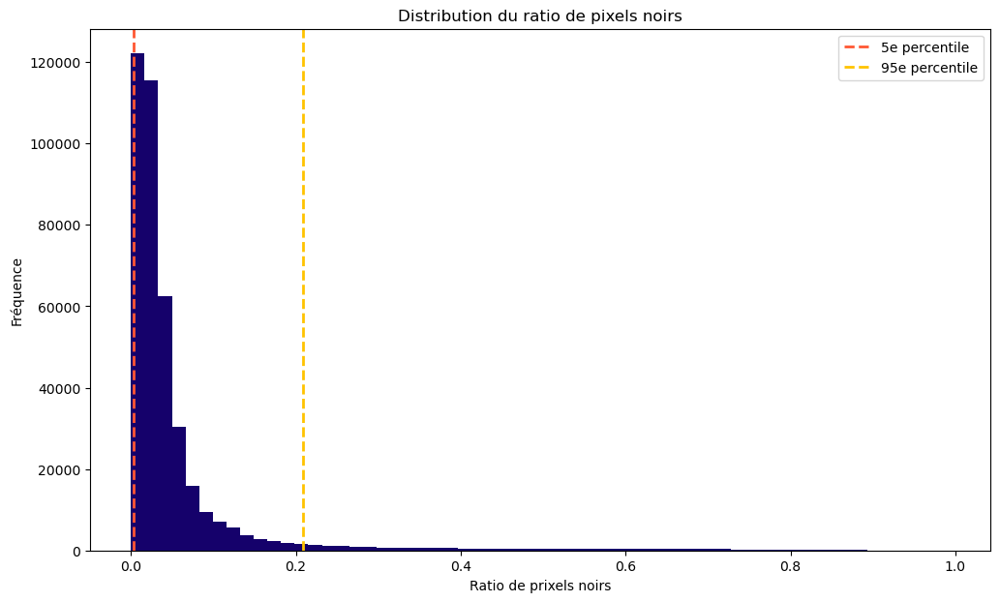

In [108]:
plt.figure(figsize=(12,7))
plt.hist(df_extract['ratio_n'], bins=60, color='#15016B')
plt.axvline(q5_rn, color='#FF5733', linestyle='dashed', linewidth=2, label='5e percentile')
plt.axvline(q95_rn, color='#FFC300', linestyle='dashed', linewidth=2, label='95e percentile')
plt.legend()
plt.xlabel("Ratio de prixels noirs")
plt.ylabel("Fréquence")
plt.title("Distribution du ratio de pixels noirs")
plt.show()

In [109]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=df_extract['ratio_b'], name="ratio pixels blancs", marker_color='rgb(255,195,0)'))
fig.add_trace(go.Histogram(x=df_extract['ratio_n'], name="ratio pixels noirs", marker_color='rgb(21, 1, 107)'))

# Change the bar mode
fig.update_layout(
    #barmode='overlay'
    title=dict(text="Histogramme des ratios du nombre de pixels blancs sur le nombre total de pixels"),
    xaxis=dict(title=dict(text="Ratio"), 
               tickmode='linear',  # Mode linéaire
               dtick=0.05             # Un tick toutes les 1 unité
              ),
    yaxis=dict(title=dict(text="Nombre de documents")),
    legend=dict(title=dict(text="ratios"))
)
fig.update_traces(opacity=0.75)
fig.show()

In [137]:
#Voyons les images avec beaucoup de bruit
# Filtrer les lignes selon le bruit
rbb_paths = df_extract[df_extract['ratio_b']<0.3]['relative_path'].to_list()
rbb_file = df_extract[df_extract['ratio_b']<0.3]['filename'].to_list()
rbb_cat = df[df['ratio_b']<0.3]['cat'].to_list()
#rbb = ratio blanc bas

# Afficher les images concernées
for i in range (len(b_paths)):
    print(rbb_paths[i]," : ", rbb_file[i]," : ", rbb_cat[i])

#attention, là j'utilise df, qui est créé un peu plus bas dans le notebook ! (pour récupérer la catégorie)

imagesa\a\a\b\aab15c00  :  2072813642.tif  :  8
imagesa\a\a\d\aad64a00  :  89432606.tif  :  5
imagesa\a\a\e\aae33d00  :  512725631.tif  :  4
imagesa\a\a\u\aau98d00  :  50407612-7613.tif  :  6
imagesa\a\b\b\abb51f00  :  0000955617.tif  :  5
imagesa\a\b\i\abi10d00  :  507144041+-4041.tif  :  4
imagesa\a\b\l\abl24e00  :  2024961531.tif  :  8
imagesa\a\b\l\abl55f00  :  0060123982.tif  :  8
imagesa\a\b\r\abr33e00  :  2050015132.tif  :  8
imagesa\a\b\t\abt05c00  :  2082057040.tif  :  8
imagesa\a\b\v\abv25c00  :  2505151718.tif  :  8
imagesa\a\c\a\aca67d00  :  2028369010.tif  :  8
imagesa\a\c\h\ach25f00  :  0060219976.tif  :  8
imagesa\a\c\l\acl05f00  :  0060175210.tif  :  8
imagesa\a\c\p\acp33e00  :  2051230220.tif  :  8


# Maintenant, on peut regarder les répartitions dans les différents sets

### On joint les dataframes pour créer df dans lequel on va travailler ensuite

In [83]:
df_train  = pd.read_csv(os.path.join(project_path, 'data', 'raw', 'train.txt'), sep=" ", header=None)
df_train.columns=['path', 'cat']
df_train['set']=['train' for i in range (len(df_train))]

df_test  = pd.read_csv(os.path.join(project_path, 'data', 'raw', 'test.txt'), sep=" ", header=None)
df_test.columns=['path', 'cat']
df_test['set']=['test' for i in range (len(df_test))]

df_val  = pd.read_csv(os.path.join(project_path, 'data', 'raw', 'val.txt'), sep=" ", header=None)
df_val.columns=['path', 'cat']
df_val['set']=['val' for i in range (len(df_val))]

#on fait un dataframe intermédiaire dans lequel on stocke les données de nos 3 dataframes. 
df_inter = pd.concat([df_train, df_test, df_val])

#maintenant, on joint ce dataframe avec celui extrait du csv initial, grâce à la colonne path
df_extract['path']=df_extract['relative_path']+'/'+df_extract['filename']
df_extract['path']=df_extract['path'].str.replace('\\', '/')
df = pd.merge(df_extract, df_inter)

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3518121321.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3518121321.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [84]:

df

,relative_path,filename,format,width,height,mode,nb_pages,nettete,bruit_grain,ratio_b,ratio_n,path,cat,set
0,imagesa\a\a\a\aaa06d00,50486482-6482.tif,TIFF,754.0,1000.0,L,1.0,0.007204,5.966084,0.950850,0.007538,imagesa/a/a/a/aaa06d00/50486482-6482.tif,6,test
1,imagesa\a\a\a\aaa08d00,2072197187.tif,TIFF,754.0,1000.0,L,1.0,0.017441,14.017837,0.854666,0.056966,imagesa/a/a/a/aaa08d00/2072197187.tif,9,train
2,imagesa\a\a\a\aaa09e00,2029372116.tif,TIFF,776.0,1000.0,L,1.0,0.004449,4.229207,0.961481,0.017421,imagesa/a/a/a/aaa09e00/2029372116.tif,11,val
3,imagesa\a\a\a\aaa10c00,2085133627a.tif,TIFF,754.0,1000.0,L,1.0,0.001255,1.049581,0.990841,0.002753,imagesa/a/a/a/aaa10c00/2085133627a.tif,2,train
4,imagesa\a\a\a\aaa11d00,515558347+-8348.tif,TIFF,754.0,1000.0,L,1.0,0.013109,12.336960,0.868765,0.069794,imagesa/a/a/a/aaa11d00/515558347+-8348.tif,3,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
399994,imagesz\z\z\z\zzz77d00,2064857737.tif,TIFF,754.0,1000.0,L,1.0,0.000810,0.732240,0.993844,0.001695,imagesz/z/z/z/zzz77d00/2064857737.tif,8,test
399995,imagesz\z\z\z\zzz83c00,2057775423.tif,TIFF,754.0,1000.0,L,1.0,0.003477,3.030334,0.971755,0.007659,imagesz/z/z/z/zzz83c00/2057775423.tif,15,train
399996,imagesz\z\z\z\zzz85c00,2073684077.tif,TIFF,754.0,1000.0,L,1.0,0.009873,9.512224,0.917780,0.030898,imagesz/z/z/z/zzz85c00/2073684077.tif,11,train
399997,imagesz\z\z\z\zzz86c00,2070718633.tif,TIFF,754.0,1000.0,L,1.0,0.007966,9.273898,0.771431,0.078243,imagesz/z/z/z/zzz86c00/2070718633.tif,4,train


### On regarde la répartition des images dans les différents dataframes selon leurs caractéristiques

Pour cela, on va commencer par faire des 'bins' pour nos variables d'intérêt, et pour chaque bin, regarder si son contenu est correctement réparti dans les 3 datasets (en proportion)

In [88]:
df['width_bins']=pd.cut(df['width'], 
                        bins=[0, 
                             np.quantile(df['width'], 0.1)-1,
                             #np.quantile(df['width'], 0.2), #en fait, Q1, Q2, Q3, Q4 et Q5 ont la même valeur...
                             #np.quantile(df['width'], 0.3),
                             #np.quantile(df['width'], 0.4),
                             np.quantile(df['width'], 0.5),
                             np.quantile(df['width'], 0.6),
                             np.quantile(df['width'], 0.7),
                             #np.quantile(df['width'], 0.8),
                             np.quantile(df['width'], 0.9),
                             df['width'].max()], 
                        labels=['min-Q1', 'Q1-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q9', 'Q9-max'],
                        include_lowest=True)

# On compte les fichiers par classe et set
df_counts = df.groupby(['width_bins', 'set']).size().reset_index(name='count')

# On calcule la proportion pour chaque classe
set_order = ['train', 'test', 'val']
class_order = ['min-Q1', 'Q1-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q9', 'Q9-max']
df_counts['set'] = pd.Categorical(df_counts['set'], categories=set_order, ordered=True)
df_counts['proportion'] = df_counts.groupby('width_bins')['count'].transform(lambda x: x / x.sum())

# Graphique en barres empilées, proportions normalisées
fig = px.bar(
    df_counts,
    x='width_bins',
    y='proportion',
    color='set',
    category_orders={'classe': class_order, 'set': set_order},
    title='Répartition des fichiers par classe de largeur et par set',
    labels={'proportion': 'Proportion', 'width_bins': 'Classe'},
    color_discrete_sequence=['rgb(87, 24, 69)', 'rgb(199, 0, 57)', 'rgb(255,87,51)']
)

fig.update_layout(barmode='stack', yaxis=dict(tickformat=".0%", title="Proportion"))
fig.show()

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3112961232.py:17: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3112961232.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [89]:
df['nettete_bins']=pd.cut(df['nettete'], 
                        bins=[0, 
                             np.quantile(df['nettete'], 0.1),
                             np.quantile(df['nettete'], 0.2), #en fait, Q1, Q2, Q3, Q4 et Q5 ont la même valeur...
                             np.quantile(df['nettete'], 0.3),
                             np.quantile(df['nettete'], 0.4),
                             np.quantile(df['nettete'], 0.5),
                             np.quantile(df['nettete'], 0.6),
                             np.quantile(df['nettete'], 0.7),
                             np.quantile(df['nettete'], 0.8),
                             np.quantile(df['nettete'], 0.9),
                             df['nettete'].max()], 
                        labels=['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max'],
                        include_lowest=True)

# On compte les fichiers par classe et set
df_counts = df.groupby(['nettete_bins', 'set']).size().reset_index(name='count')

# On calcule la proportion pour chaque classe
set_order = ['train', 'test', 'val']
class_order = ['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max']
df_counts['set'] = pd.Categorical(df_counts['set'], categories=set_order, ordered=True)
df_counts['proportion'] = df_counts.groupby('nettete_bins')['count'].transform(lambda x: x / x.sum())

# Graphique en barres empilées, proportions normalisées
fig = px.bar(
    df_counts,
    x='nettete_bins',
    y='proportion',
    color='set',
    category_orders={'nettete_bins': class_order, 'set': set_order},
    title='Répartition des fichiers par classe de netteté et par set',
    labels={'proportion': 'Proportion', 'nettete_bins': 'Classe'},
    color_discrete_sequence=['rgb(87, 24, 69)', 'rgb(199, 0, 57)', 'rgb(255,87,51)']
)

fig.update_layout(barmode='stack', yaxis=dict(tickformat=".0%", title="Proportion"))
fig.show()

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\2126915907.py:17: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\2126915907.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [90]:
df['bruit_grain_bins']=pd.cut(df['bruit_grain'], 
                        bins=[0, 
                             np.quantile(df['bruit_grain'], 0.1),
                             np.quantile(df['bruit_grain'], 0.2), #en fait, Q1, Q2, Q3, Q4 et Q5 ont la même valeur...
                             np.quantile(df['bruit_grain'], 0.3),
                             np.quantile(df['bruit_grain'], 0.4),
                             np.quantile(df['bruit_grain'], 0.5),
                             np.quantile(df['bruit_grain'], 0.6),
                             np.quantile(df['bruit_grain'], 0.7),
                             np.quantile(df['bruit_grain'], 0.8),
                             np.quantile(df['bruit_grain'], 0.9),
                             df['bruit_grain'].max()], 
                        labels=['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max'],
                        include_lowest=True)

# On compte les fichiers par classe et set
df_counts = df.groupby(['bruit_grain_bins', 'set']).size().reset_index(name='count')

# On calcule la proportion pour chaque classe
set_order = ['train', 'test', 'val']
class_order = ['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max']
df_counts['set'] = pd.Categorical(df_counts['set'], categories=set_order, ordered=True)
df_counts['proportion'] = df_counts.groupby('bruit_grain_bins')['count'].transform(lambda x: x / x.sum())

# Graphique en barres empilées, proportions normalisées
fig = px.bar(
    df_counts,
    x='bruit_grain_bins',
    y='proportion',
    color='set',
    category_orders={'bruit_grain_bins': class_order, 'set': set_order},
    title='Répartition des fichiers par classe de bruit/grain et par set',
    labels={'proportion': 'Proportion', 'bruit_grain_bins': 'Classe'},
    color_discrete_sequence=['rgb(87, 24, 69)', 'rgb(199, 0, 57)', 'rgb(255,87,51)']
)

fig.update_layout(barmode='stack', yaxis=dict(tickformat=".0%", title="Proportion"))
fig.show()

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\1042764615.py:17: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\1042764615.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [91]:
df['ratio_b_bins']=pd.cut(df['ratio_b'], 
                        bins=[0, 
                             np.quantile(df['ratio_b'], 0.1),
                             np.quantile(df['ratio_b'], 0.2), #en fait, Q1, Q2, Q3, Q4 et Q5 ont la même valeur...
                             np.quantile(df['ratio_b'], 0.3),
                             np.quantile(df['ratio_b'], 0.4),
                             np.quantile(df['ratio_b'], 0.5),
                             np.quantile(df['ratio_b'], 0.6),
                             np.quantile(df['ratio_b'], 0.7),
                             np.quantile(df['ratio_b'], 0.8),
                             np.quantile(df['ratio_b'], 0.9),
                             df['ratio_b'].max()], 
                        labels=['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max'],
                        include_lowest=True)

# On compte les fichiers par classe et set
df_counts = df.groupby(['ratio_b_bins', 'set']).size().reset_index(name='count')

# On calcule la proportion pour chaque classe
set_order = ['train', 'test', 'val']
class_order = ['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max']
df_counts['set'] = pd.Categorical(df_counts['set'], categories=set_order, ordered=True)
df_counts['proportion'] = df_counts.groupby('ratio_b_bins')['count'].transform(lambda x: x / x.sum())

# Graphique en barres empilées, proportions normalisées
fig = px.bar(
    df_counts,
    x='ratio_b_bins',
    y='proportion',
    color='set',
    category_orders={'ratio_b_bins': class_order, 'set': set_order},
    title='Répartition des fichiers par classe de ratio de pixels blancs et par set',
    labels={'proportion': 'Proportion', 'ratio_b_bins': 'Classe'},
    color_discrete_sequence=['rgb(87, 24, 69)', 'rgb(199, 0, 57)', 'rgb(255,87,51)']
)

fig.update_layout(barmode='stack', yaxis=dict(tickformat=".0%", title="Proportion"))
fig.show()

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\2674415208.py:17: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\2674415208.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [92]:
df['ratio_n_bins']=pd.cut(df['ratio_n'], 
                        bins=[0, 
                             np.quantile(df['ratio_n'], 0.1),
                             np.quantile(df['ratio_n'], 0.2), #en fait, Q1, Q2, Q3, Q4 et Q5 ont la même valeur...
                             np.quantile(df['ratio_n'], 0.3),
                             np.quantile(df['ratio_n'], 0.4),
                             np.quantile(df['ratio_n'], 0.5),
                             np.quantile(df['ratio_n'], 0.6),
                             np.quantile(df['ratio_n'], 0.7),
                             np.quantile(df['ratio_n'], 0.8),
                             np.quantile(df['ratio_n'], 0.9),
                             df['ratio_n'].max()], 
                        labels=['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max'],
                        include_lowest=True)

# On compte les fichiers par classe et set
df_counts = df.groupby(['ratio_n_bins', 'set']).size().reset_index(name='count')

# On calcule la proportion pour chaque classe
set_order = ['train', 'test', 'val']
class_order = ['min-Q1', 'Q1-Q2', 'Q2-Q3', 'Q3-Q4', 'Q4-Q5', 'Q5-Q6', 'Q6-Q7', 'Q7-Q8', 'Q8-Q9', 'Q9-max']
df_counts['set'] = pd.Categorical(df_counts['set'], categories=set_order, ordered=True)
df_counts['proportion'] = df_counts.groupby('ratio_n_bins')['count'].transform(lambda x: x / x.sum())

# Graphique en barres empilées, proportions normalisées
fig = px.bar(
    df_counts,
    x='ratio_n_bins',
    y='proportion',
    color='set',
    category_orders={'ratio_b_bins': class_order, 'set': set_order},
    title='Répartition des fichiers par classe de ratio de pixels noirs et par set',
    labels={'proportion': 'Proportion', 'ratio_n_bins': 'Classe'},
    color_discrete_sequence=['rgb(87, 24, 69)', 'rgb(199, 0, 57)', 'rgb(255,87,51)']
)

fig.update_layout(barmode='stack', yaxis=dict(tickformat=".0%", title="Proportion"))
fig.show()

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3051985744.py:17: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\lesca\AppData\Local\Temp\ipykernel_14284\3051985744.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

